# Homework 8
**Total Points: 5**

**Instructions:**
1. Complete parts 1 through 5, filling in code or responses where marked with `# YOUR CODE HERE` or `# YOUR ANALYSIS HERE`.
2. The libraries you need have already been coded. Do not import additional libraries or move import commands.
3. When finished, run the full notebook by selecting <b>Kernel > Restart & Run All</b>. </li>
4. Submit this completed notebook file to <b>NYU Classes</b>. </li>**(Important: Only submit your .ipynb file! Do not submit the entire dataset.)**

In this assignment you will test several different techniques to estimate pitches (f0) over time of monophonic audio signals. This assignment uses a new library, `crepe`, which contains additional signal processing tools. More information about the library is available here: 

<blockquote>
Kim, Jong Wook, et al. "CREPE: A convolutional representation for pitch estimation." 2018 IEEE International Conference on Acoustics, Speech and Signal Processing (ICASSP). IEEE, 2018
</blockquote>

**Grading:** Each part is worth 1 point.

## Prologue: Download Data and Crepe

All audio and data files are included with this assignment. Additionally, **Crepe** is a pitch tracking algorithm. You can download and install is using `pip install crepe` from the command line. 
    
Download and extract both the dataset and the pitch tracking data. Place the data into folders in the same directory as your `Homework-8.ipynb` file, such that the folder stucture is:

`
 <--   Homework-8.ipynb
 <--   data
 |     <--   *.txt files      
 <--   audio 
 |     <--   *.wav files
`

The `*.wav` audio files contain recordings of different solo instruments. Each audio file has a matching filename `*.txt`, which contains ground truth times for pitch tracking, with each line containing the following information:

`time     frequency`

To import this information, use `numpy.loadtxt()`. To get all the filenames in a specific directory, use the `os` library as follows, where each row contains the following data:

`
for filename in os.listdir("audio/"):
    if filename.endswith(".wav"):
        ...
`

Portions of the dataset used in this assignment are from `MedleyDB-Pitch`.

<blockquote>
Bittner, R., Wilkins, J., Yip, H., & Bello, J. (2016). MedleyDB 2.0: New Data and a System for Sustainable Data Collection. New York, NY, USA: International Conference on Music Information Retrieval (ISMIR-16).
</blockquote>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import crepe
import librosa
import IPython
from mir_eval.melody import evaluate
from mir_eval.sonify import pitch_contour
from madmom.features.beats import RNNBeatProcessor

# Adding this to get rid of crepe warnings
import warnings
warnings.filterwarnings('ignore')


In [2]:
# Helper function to get the ground truth pitch contour

def get_truth(file_dir):
    '''Get truth data from text file.
    
    Parameters
    ----------
    file_dir : str
        File name (*.txt) and path to ground truth

    Returns
    -------
    times : np.array
        stimes of each frequency
    frequencies: np.array
        Estimated frequency at corresponding time
        
    '''
    
    times = np.array([])
    frequencies = np.array([])
    data = np.loadtxt(file_dir)
    for i in data:
        times = np.append(times,i[0])
        frequencies = np.append(frequencies,i[1])
    return times, frequencies


In [3]:
# Test  mir_eval's pitch_countour() and the included get_truth() code
# This code shows how these functions work

file = "003"
time_test, freq_test = get_truth("pitch/" + file + ".txt")
pc2, sr = librosa.load("audio/" + file + ".wav")
pc = pitch_contour(time_test,freq_test, fs=sr)
a1 = IPython.display.Audio(pc,rate=sr)
a2 = IPython.display.Audio(pc2,rate=sr)

print("Real Audio:")
IPython.display.display(a2)
print("Synthesized Ground Truth Pitch Contour:")
IPython.display.display(a1)


Real Audio:


Synthesized Ground Truth Pitch Contour:


## Part 1: Estimate Pitch

Write a function `estimate_pitch()` which provides pitch estimation for a momphonic audio signal over time using the following methods (most of these have prewritten library functions): 

- spectrogram argmax for each m in the STFT matgnitude spectrum
- time domain autocorrelation (see https://musicinformationretrieval.com/autocorrelation.html)
- YIN
- the Crepe pitch tracking algorithm

See Crepe's documentation [here](https://github.com/marl/crepe). *Hint:* Look for the section in the readme titled "using crepe inside python". Note that you can use `librosa`, instead of `scipy` to load audio.


In [4]:
def estimate_pitch(audio_path, method, n_fft=2048, voicing_threshold=10, use_viterbi=True):
    """Estimate the pitch of an audio_path using one of the 4 above algorithm, and using a threshold
       on the voicing confidence to determine when frames are unvoiced.
    
    Parameters
    ----------
    audio_path : str
        Path to input audio file
    N : int
        frame length, if applicable
    voicing_threshold : float
        Threshold on the voicing to determine which frames are unvoiced.
    type : str
        one of 'autocorrelation', 'argmax', 'yin', or 'crepe' 
    use_viterbi : bool
        If True, use the Viterbi algorithm to select the final output
    
    Returns
    -------
    times : np.ndarray shape=(T,)
        Numpy array of time stamps of length T in seconds
    frequencies : np.ndarray shape=(T,)
        Numpy array of predicted frequency values in Hz

    """
    # Prepare data
    data, fs = librosa.load( audio_path )
    N = len( data )
    times = []
    frequencies = []
    
    # I changed "type" to "method" because type is a reserved keyword in Python
    if method == "argmax":
        # Get salience representation of STFT
        STFT = np.abs( librosa.stft( data, n_fft=n_fft ) )
        freqs = librosa.core.fft_frequencies(fs)
        harms = [1, 2, 3, 4]
        weights = [1.0, 0.5, 0.33, 0.25]
        STFT_salience = librosa.salience(STFT, freqs, harms, weights, fill_value=0)
        STFT_salience[STFT_salience < voicing_threshold] = 0
        # Find the most salient frequency bins for frequencies
        frequency_bins = np.argmax( STFT_salience, axis = 0 )
        frequencies = frequency_bins * ( fs / n_fft )
        times = np.linspace( 0, N / fs, STFT_salience.shape[1] )
    
    elif method == "autocorrelation":
        # Slice the signal up to time slices of size n_fft
        signal_slices = []
        start = 0
        end = n_fft
        while end <= N: 
            signal_slices.append( data[ start: end ])
            start += n_fft
            end += n_fft
        signal_slices = np.array(signal_slices).T
        
        # Setting the lowest frequency threshold to 20 Hz
        max_period_in_samples = (1/20.) * fs
        
        # Compute auto-correlation
        r = librosa.autocorrelate( signal_slices , max_size = max_period_in_samples, axis = 0 )
        
        # Getting rid of freqencies above 4000 Hz
        min_period_in_samples = ( 1/4000. ) * fs
        r[: int(np.ceil(min_period_in_samples)), :] = 0
        
        # Find the max correlation index and convert to frequncies
        most_correlated_time_indices = np.argmax( r, axis = 0 )
        frequencies = np.array([ fs / index if index > 0 else 0 for index in most_correlated_time_indices ])
            
        # Get times
        times = np.linspace( 0, N / fs, r.shape[1] )
    
    elif method == "yin":
        frequencies, voiced, _ = librosa.pyin( data, fmin=20, fmax=4000, sr=fs, frame_length=2048 )
        frequencies *= voiced
        frequencies = np.nan_to_num(frequencies)
        times = np.linspace(0, N / fs, len(frequencies) )
        
    elif method == "crepe":
        import tensorflow
        times, frequencies, _, _ = crepe.predict(data, fs, viterbi=use_viterbi)
    
    else:
        print("method not specified, please choose from one of 'autocorrelation', 'argmax', 'yin', or 'crepe'") 
    return times, frequencies

## Part 2: Plot and Sonify Pitch Contour

Create a function `plot_and_sonify()` that will plot all 4 estimated pitch contours in a single figure with 4 subplots (4 rows and 1 column). The function should also create 4 IPython audio players, one for each of the pitch contours. See the example in the Prologue for assistance with creating the pitch contour audio file.

**Hint:** To plot the pitch contour, use `plt.plot(time, frequency,'x')` so that each plot doesn't have connecting lines to each other. Also ensure that the axes are properly labeled.

In [5]:
# --------------------------------------<!> I added "method" and "fs" here for plotting titles
#                                       \/  and synthesizing the pitch contour
def plot_and_sonify(times, frequencies, method, fs):
    ''' Plot and sonify the estimated pitches of an audio file
    
    Parameters
    ----------
    times : np.ndarray shape=(T,)
        Numpy array of time stamps of length T in seconds
    frequencies : np.ndarray shape=(T,)
        Numpy array of predicted frequency values in Hz
    method: str
        one of 'autocorrelation', 'argmax', 'yin', or 'crepe' 
    fs: int
        sample rate for pitch contour
    Returns
    -------
    none
    
    '''
    p_contour = pitch_contour(times, frequencies, fs=fs)
    plt.figure(figsize = ( 10, 5 ))
    plt.ylim(30, np.nanmax(frequencies) + 200)
    plt.xlabel( "Time (seconds)")
    plt.ylabel( "Frequency (Hz)" )
    plt.title( "Pitch tracking using " + method)
    plt.plot(times, frequencies, 'ro')
    plt.show()
    synthesized_pitch = IPython.display.Audio(p_contour, rate=fs)
    IPython.display.display(synthesized_pitch)
    
    return


51/51 [==============================] - 8s 160ms/step


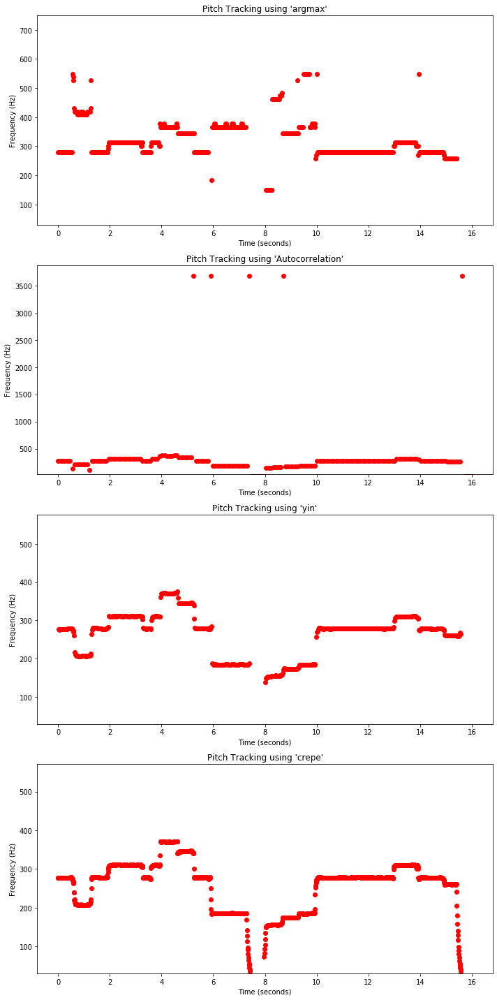

In [20]:
def plot_and_sonify_four_algorithms( audio_path ):    
    
    _, fs = librosa.load( audio_path )
    
    # Argmax
    times, frequencies = estimate_pitch(audio_path, "argmax")
    plt.figure(figsize = ( 10, 20 ))
    plt.subplot(411)
    plt.ylim(30, np.nanmax(frequencies) + 200)
    plt.xlabel( "Time (seconds)")
    plt.ylabel( "Frequency (Hz)" )
    plt.title("Pitch Tracking using 'argmax'")
    plt.plot(times, frequencies, 'ro')
    p_contour = pitch_contour(times, frequencies, fs=fs)
    synthesized_pitch_argmax = IPython.display.Audio(p_contour, rate=fs)
    IPython.display.display(synthesized_pitch_argmax)
    
    # Autocorrelation
    times, frequencies = estimate_pitch(audio_path, "autocorrelation")
    plt.subplot(412)
    plt.ylim(30, np.nanmax(frequencies) + 200)
    plt.xlabel( "Time (seconds)")
    plt.ylabel( "Frequency (Hz)" )
    plt.title("Pitch Tracking using 'Autocorrelation'")
    plt.plot(times, frequencies, 'ro')
    p_contour = pitch_contour(times, frequencies, fs=fs)
    synthesized_pitch_auto = IPython.display.Audio(p_contour, rate=fs)
    IPython.display.display(synthesized_pitch_auto)   
    
    # yin
    times, frequencies = estimate_pitch(audio_path, "yin")
    plt.subplot(413)
    plt.ylim(30, np.nanmax(frequencies) + 200)
    plt.xlabel( "Time (seconds)")
    plt.ylabel( "Frequency (Hz)" )
    plt.title("Pitch Tracking using 'yin'")    
    plt.plot(times, frequencies, 'ro')
    p_contour = pitch_contour(times, frequencies, fs=fs)
    synthesized_pitch_yin = IPython.display.Audio(p_contour, rate=fs)
    IPython.display.display(synthesized_pitch_yin)
    
    # crepe
    times, frequencies = estimate_pitch(audio_path, "crepe")
    plt.subplot(414)
    plt.ylim(30, np.nanmax(frequencies) + 200)
    plt.xlabel( "Time (seconds)")
    plt.ylabel( "Frequency (Hz)" )
    plt.title("Pitch Tracking using 'crepe'")   
    plt.plot(times, frequencies, 'ro')
    p_contour = pitch_contour(times, frequencies, fs=fs)
    synthesized_pitch_crepe = IPython.display.Audio(p_contour, rate=fs)
    IPython.display.display(synthesized_pitch_crepe)
    
    plt.tight_layout()
    plt.show()
    return
plot_and_sonify_four_algorithms( "audio/001.wav" )

## Part 3: Evaluate Results

There are a total of 9 audio files (000 - 008) with corresponding truth pitch contours. Using the `mir_eval` `evaluate` function, calculate the overall accuracy of each file, for all 4 pitch tracking algorithms (this may require a nested loop).

1. Find the algorithn with the overall best accuracy and the algorithm with the overall worst accuracy.
2. Find the audio file that has the best accuracy and the audio file with the worst accuracy.
3. Plot and sonify both of those pitch contours.

In [7]:
#Evaluate results

import os

filenames = []

argmax_scores = []
autocorrelation_scores = []
yin_scores = []
crepe_scores = []

for filename in os.listdir("pitch/"):
    if filename.endswith(".txt"):
        times_label, frequencies_label = get_truth("pitch/" + filename)
        filename = filename[:-4]
        audio_path = "audio/" + filename + ".wav"
        filenames.append(filename)
        
        # argmax
        times, frequencies = estimate_pitch(audio_path, "argmax")
        score = evaluate( times_label, frequencies_label, times, frequencies )
        argmax_scores.append( score["Overall Accuracy"] )
        # autocorrelation
        times, frequencies = estimate_pitch(audio_path, "autocorrelation")
        score = evaluate( times_label, frequencies_label, times, frequencies )
        autocorrelation_scores.append( score["Overall Accuracy"] )
        # yin
        times, frequencies = estimate_pitch(audio_path, "yin")
        score = evaluate( times_label, frequencies_label, times, frequencies )
        yin_scores.append( score["Overall Accuracy"] )
        # crepe
        times, frequencies = estimate_pitch(audio_path, "crepe")
        score = evaluate( times_label, frequencies_label, times, frequencies )
        crepe_scores.append( score["Overall Accuracy"] )

# for filename in os.listdir("audio/"):
#     if filename.endswith(".wav"):
#         ...
# YOUR CODE HERE

64/64 [==============================] - 11s 179ms/step


Argmax: 
0.5769084702727331

Auto-correlation: 
0.5269840522513269

Yin: 
0.7612944320230509

CREPE: 
0.8013717874178858


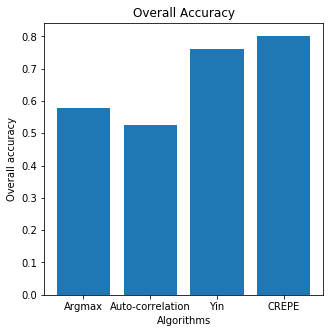

We can see that the overall most accurate algorithm is crepe, and the least accurate is Auto-Correlation


In [8]:
print("Argmax: ")
print(np.mean(argmax_scores))
print("\nAuto-correlation: ")
print(np.mean(autocorrelation_scores))
print("\nYin: ")
print(np.mean(yin_scores))
print("\nCREPE: ")
print(np.mean(crepe_scores))

labels = ['Argmax', 'Auto-correlation', 'Yin', 'CREPE']
scores = [np.mean(argmax_scores), np.mean(autocorrelation_scores), np.mean(yin_scores), np.mean(crepe_scores)]

plt.figure(figsize = (5, 5))
plt.bar(labels, scores)
plt.xlabel("Algorithms")
plt.ylabel("Overall accuracy")
plt.title("Overall Accuracy")

plt.show()

print("We can see that the overall most accurate algorithm is crepe, and the least accurate is Auto-Correlation")

The best tracking results is obtained from 001.wav. 
using crepe method.

The worst tracking results is obtained from 000.wav. 
using autocorrelation method.

Here's how they sound: 
Best track: 001.wav
51/51 [==============================] - 9s 177ms/step


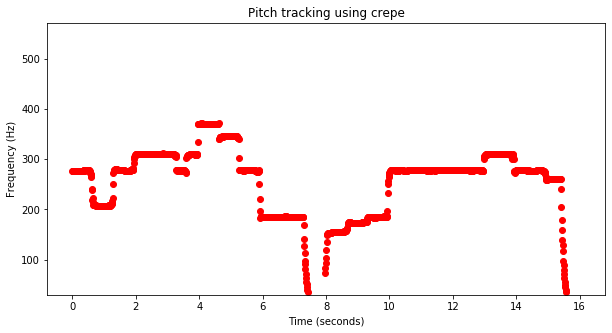


Worst track: 000.wav


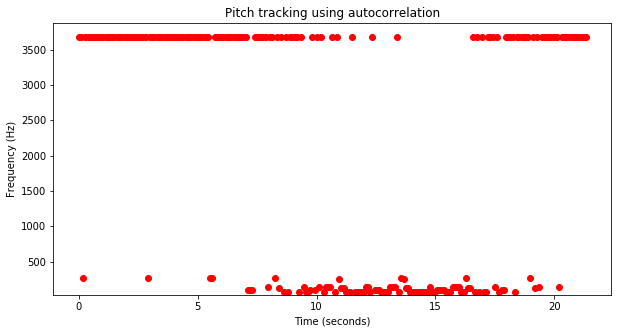

In [9]:
# Audiofile with best and worst accuracy across algorithms
scores = np.array([argmax_scores, autocorrelation_scores, yin_scores, crepe_scores])
best_index = scores.argmax() % len(filenames)
worst_index = scores.argmin() % len(filenames)

best_file = filenames[best_index]
worst_file = filenames[worst_index]

algorithms = ["argmax", "autocorrelation", "yin", "crepe"]
best_file_algorithm = algorithms[ scores.argmax() // len(filenames) ]
worst_file_algorithm = algorithms[ scores.argmin() // len(filenames) ]

print( "The best tracking results is obtained from " + best_file + ".wav. ")
print( "using " + best_file_algorithm + " method.")
print()

print( "The worst tracking results is obtained from " + worst_file + ".wav. ")
print( "using " + worst_file_algorithm + " method.")
print()

print("Here's how they sound: ")
print("Best track: {}.wav".format(best_file))
_, fs = librosa.load( "audio/" + best_file + ".wav" )
times, frequencies = estimate_pitch( "audio/" + best_file + ".wav", best_file_algorithm )
plot_and_sonify( times, frequencies, best_file_algorithm, fs)

print("\nWorst track: {}.wav".format(worst_file))
_, fs = librosa.load( "audio/" + worst_file + ".wav" )
times, frequencies = estimate_pitch( "audio/" + worst_file + ".wav", worst_file_algorithm )
plot_and_sonify( times, frequencies, worst_file_algorithm, fs )

## Part 4: Plot Pitch Contour with Estimated Beats

Select 2 or 3 audio files from this assignment. Plot the best estimated pitch contour for each file (not the reference) and then overlay the plot with vertical lines indicating the best estimated beats (not the reference beats) as obtained from the estimate_beats() function in assignment 7.

1. Copy `estimate_beats()` from Homework 7
2. Use `estimate_pitch()` to get the pitch contour from your selected file(s)
3. Use `estimate_beats()` to get the beats for that file
4. Plot them both together on the same plot.
5. OPTIONAL: Sonify the pitch contour + the estimated beat positions. 

In [10]:
# COPY this function from Homework 7.
import madmom 

def mix ( data1, data2 ):
    """Mixes two audio signals together
    
    Parameters
    ----------
    data1: audio data (numpy array)
    
    data2: audio data (numpy array)

    Returns
    -------
    a single numpy array of mixed signal  
    """
    
    length1 = len(data1)
    length2 = len(data2)
    
    if length1 > length2:
        data1[ : length2] += data2
    else:
        data1 += data2[ : length1]

    return data1

def estimate_beats(audio_path, onset_type = "machine_learning", plot=False):
    """Compute beat positions using either a spectral flux or a machine learned onset novelty function,
    followed by computing a tempogram and PLP.
    
    Parameters
    ----------
    audio_path : str
        Path to input audio file
    onset_type : str
        One of 'spectral_flux' or 'machine_learning'
    plot : bool
        If True, plots the onset novelty curve and the estimated beat positions.

    Returns
    -------
    beat_times : 1-d np.array
        Array of time stamps of the estimated beats in seconds.

    """
    # Load data
    data, sr = librosa.load( audio_path )
    T = len( data ) / sr 
    
    # Compute beats using RNN
    if onset_type == "machine_learning": 
        
        # Initialize the RNN processor from madmom
        RNN_beat_proc = madmom.features.beats.RNNBeatProcessor()
        
        # Calculate the probablity at 100 frames per second
        rnn_pulse_probs = RNN_beat_proc( audio_path )
        
        # Using PLP to obtain beat locations from the probability curve.
        # Then converting the results to frame numbers
        beats_rnn = np.nonzero( librosa.util.localmax(
            librosa.beat.plp( onset_envelope = rnn_pulse_probs, sr = sr ) ) )
        
        # Normalize the x-axis
        times_rnn = np.linspace( 0, T, len( rnn_pulse_probs ) )
        if plot:
            plt.plot(times_rnn, rnn_pulse_probs, label='RNN Probability')
            plt.vlines(times_rnn[beats_rnn], 0, 1000, 
                       alpha=0.5, color='r', linestyle='--', label='RNN Beats')
            plt.legend()
            plt.ylabel("Probability")
            plt.xlabel("Time (seconds)")
            plt.title('RNNBeatProcessor')
        return times_rnn[beats_rnn]
    
def plot_and_sonify_with_beats( audio_path, method ):
    data, fs = librosa.load( audio_path )
    N = len( data )
    T = N / fs
    
    times, frequencies = estimate_pitch( audio_path, method )
    p_contour = pitch_contour(times, frequencies, fs=fs)
    plt.figure(figsize = ( 10, 5 ))
    plt.ylim(30, np.nanmax(frequencies) + 200)
    plt.xlabel( "Time (seconds)")
    plt.ylabel( "Frequency (Hz)" )
    plt.title( "Pitch tracking using " + method)
    plt.plot(times, frequencies, 'ro', label = "Pitch" + "({})".format(method))
    
    beat_times_ml = estimate_beats( audio_path, "machine_learning", plot=False)
    beats_in_samples = np.array([ int( beat_time * fs ) for beat_time in beat_times_ml ]) - 1
    time_axis = np.linspace(0, T, len(p_contour))
    plt.vlines(time_axis[beats_in_samples], 
               30, np.nanmax(frequencies) + 200, alpha=0.5, 
               color='g', linestyle='--', label='Beat Prediction using RNN')
    plt.legend()
    ml_click = librosa.clicks( times = beat_times_ml, sr = fs )
    ml_click = mix(ml_click, p_contour)
    plt.show()
    
    print("Synthesized voice contour using {}, with RNN beat predictions: ".format(method))
    ml_click_audio = IPython.display.Audio(ml_click, rate = fs)
    IPython.display.display(ml_click_audio)

    return

51/51 [==============================] - 10s 187ms/step


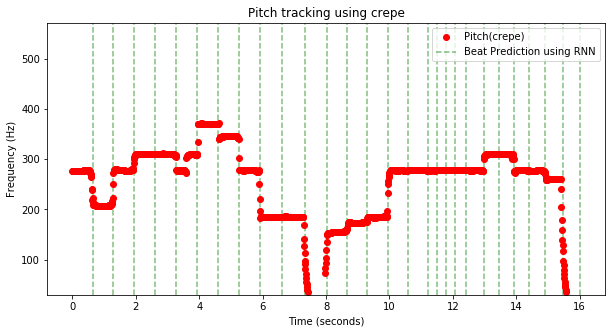

Synthesized voice contour using crepe, with RNN beat predictions: 


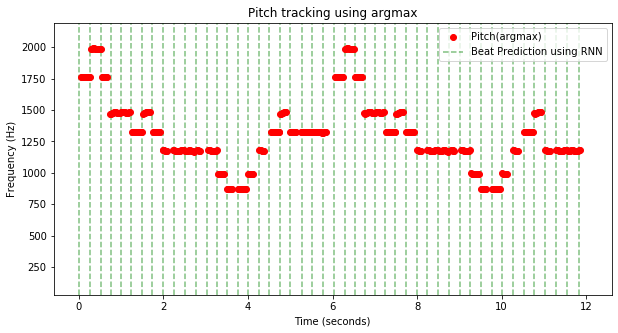

Synthesized voice contour using argmax, with RNN beat predictions: 


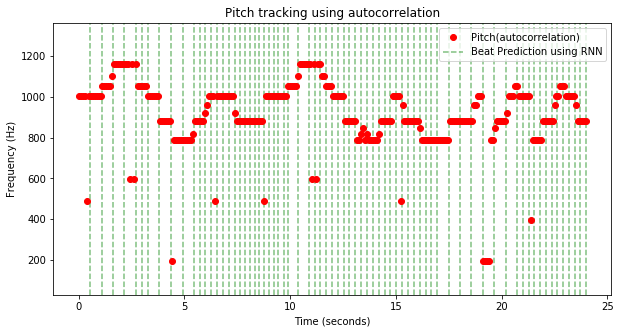

Synthesized voice contour using autocorrelation, with RNN beat predictions: 


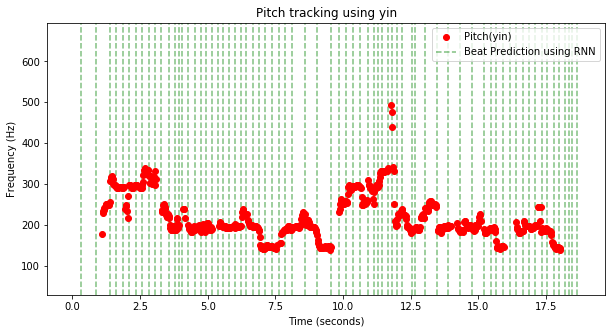

Synthesized voice contour using yin, with RNN beat predictions: 


In [11]:
# Plot pitch contour overlayed with vertical lines indicating estimatesd beat positions
# Try this on at least 3 different files.
# Do the beats align with the pitches in a musically meaningful way?

# YOUR CODE HERE

plot_and_sonify_with_beats( 'audio/001.wav', "crepe" )
plot_and_sonify_with_beats( 'audio/002.wav', "argmax" )
plot_and_sonify_with_beats( 'audio/003.wav', "autocorrelation" )
plot_and_sonify_with_beats( 'audio/004.wav', "yin" )


`Yes, the beats do align with pitch changes in a meaningful way.`

## Part 5: Analysis

Using the plots from part 2 and the evaluation from part 3, identify 3 trends in the results. Feel free to create additional plots/audio sonifications to identify trends. For each trend, write a short paragraph discussing what is happening and why you think it might be occurring. For example, when and possibly why did the pitch tracking work best and when did the pitch tracking fail?

#### Scores Overview: 

In [12]:
import pandas as pd

print("Scores per track per algorithm: ")
scores_all = np.array([ argmax_scores, autocorrelation_scores, yin_scores, crepe_scores ] )
scores_df = pd.DataFrame(data=scores_all, index=algorithms, columns=filenames, dtype=None, copy=False)
scores_df

Scores per track per algorithm: 


,003,002,000,001,005,004,006,007,008
argmax,0.915981,0.905917,0.167802,0.737741,0.621300,0.577581,0.407223,0.381728,0.476905
autocorrelation,0.813559,0.631426,0.148189,0.879041,0.646075,0.408941,0.503736,0.257790,0.454099
yin,0.930266,0.797769,0.633615,0.952416,0.870335,0.705457,0.784558,0.432720,0.744515
crepe,0.953027,0.848206,0.533642,0.960770,0.906692,0.743918,0.846202,0.727337,0.692552


Let's look at how each file scores on average across the four algorithms on an ascending scale

In [13]:
print("Average scores for each track: ")
scores_df.mean(axis = 0).sort_values()

Average scores for each track: 


000    0.370812
007    0.449894
008    0.592018
004    0.608974
006    0.635430
005    0.761100
002    0.795829
001    0.882492
003    0.903208
dtype: float64

Let's now hear the worst performing track: 000.wav, as it is. 

In [14]:
data, fs = librosa.load( "audio/000.wav" )
IPython.display.Audio( data, rate = fs )

It sounds like there's a filter opening up, exposing a lot of higher harmonics. At the same time, the rhthmic pattern is alternating rapidly, often in half steps. 

Now let's look at how the four algorithms performed on this track. For whatever reason, madmom can't read this file, so I'm skipping beat tracking for now. 

67/67 [==============================] - 11s 172ms/step


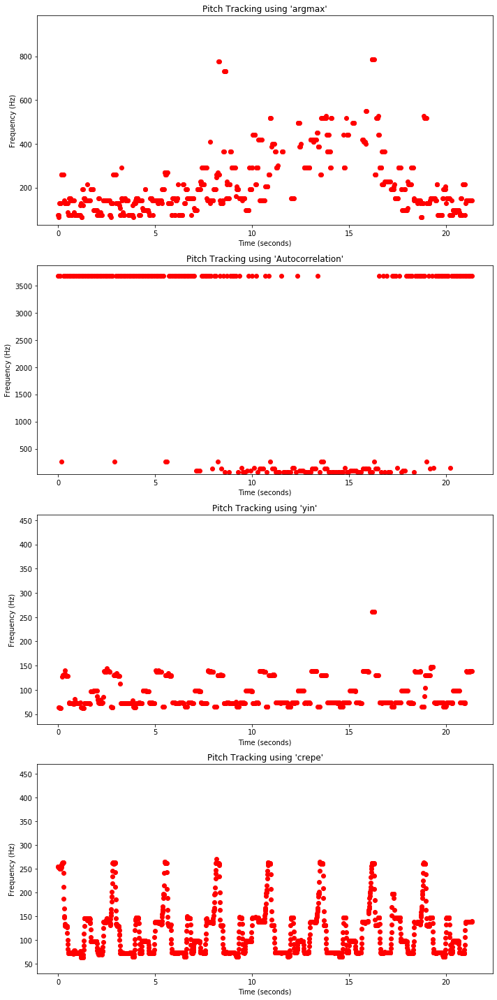

In [21]:
plot_and_sonify_four_algorithms( "audio/000.wav" )

It looks like, yin and crepe is doing okay, but autocorrelation and argmax are just really confused. One pattern we have been seeing with 'crepe' is that it does not offer a clear cut voicing as notes change, thus giving a portamento quality to it's synthesized contours. For argmax, the filter opening up seems to affect the overall direction of the pitch contour. This is probably due to the salience of upper harmonics being higher as the filter opens up. Auto-correlation can't really decide what's the correct pitch at all... This maybe due to the fact that the track contains lots of fastly repeating closely spaced notes, that the lag factor can't land in an accurate result. 

Now let's take a look at the second worst file: 007.wav. Here's how it sounds

In [16]:
data, fs = librosa.load( "audio/007.wav" )
IPython.display.Audio(data, rate = fs)

Okay, upon hearing, we are probably already sensing trouble;) It's a human singing sample, featuring lot's of rhythmic, consonent changes, as well as vibrato. Let's see how the algorithms think of it. 

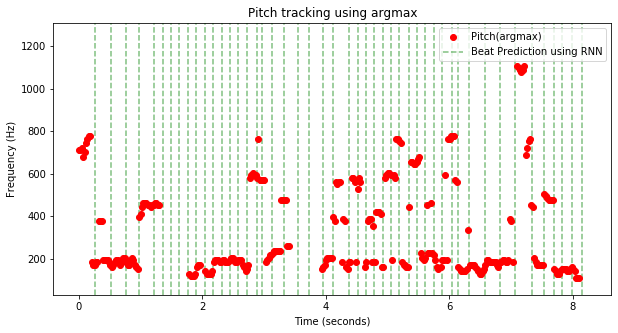

Synthesized voice contour using argmax, with RNN beat predictions: 


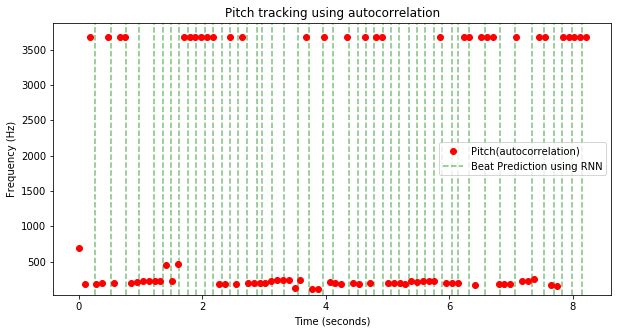

Synthesized voice contour using autocorrelation, with RNN beat predictions: 


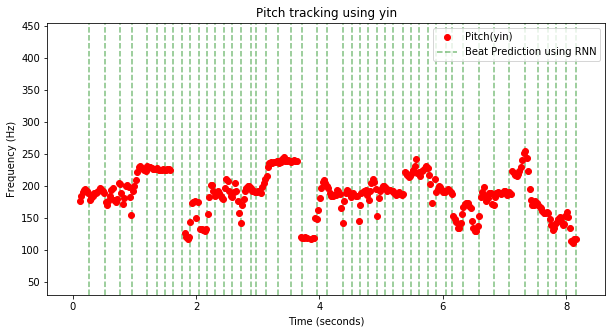

Synthesized voice contour using yin, with RNN beat predictions: 


26/26 [==============================] - 4s 160ms/step


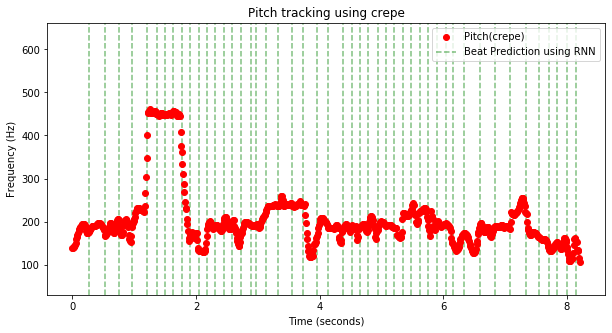

Synthesized voice contour using crepe, with RNN beat predictions: 


In [17]:
plot_and_sonify_with_beats( 'audio/007.wav', "argmax" )
plot_and_sonify_with_beats( 'audio/007.wav', "autocorrelation" )
plot_and_sonify_with_beats( 'audio/007.wav', "yin" )
plot_and_sonify_with_beats( 'audio/007.wav', "crepe" )

I won't analyze why the beats are so off as it's done last week. But from this track we can see that, except for yin, almost all other algorithms have trouble reading the correct octave from the voice. For argmax, it's often 2 or 3 octaves above what the correct output should be. For crepe, it happend once at the beginning. For auto-correlation, similar things happend, but on a much higher scale. This could just be the rich harmonics of the singer's voice that can be confusing to the algorithms

Lastly, let's look at a track that all algorithms did well on: 003.wav. Here's how it sounds

In [18]:
data, fs = librosa.load("audio/003.wav")
IPython.display.Audio(data, rate = fs)

Ah, 23 seconds of ode to joy. No wonder the algorithms are well. Let's see how they did:

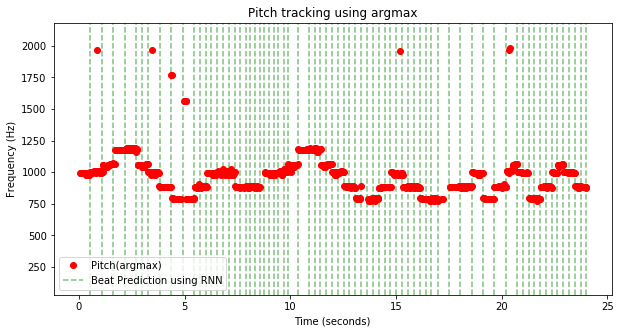

Synthesized voice contour using argmax, with RNN beat predictions: 


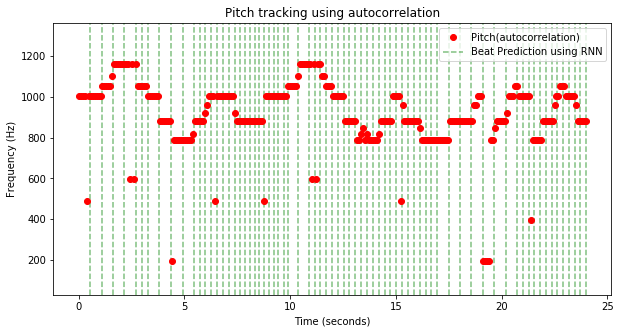

Synthesized voice contour using autocorrelation, with RNN beat predictions: 


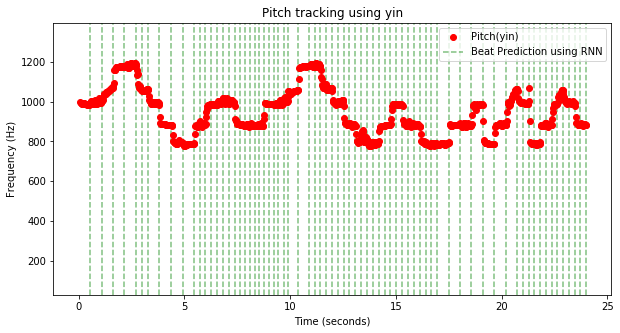

Synthesized voice contour using yin, with RNN beat predictions: 


76/76 [==============================] - 12s 161ms/step


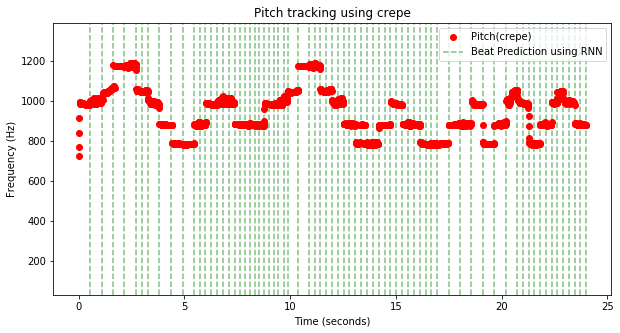

Synthesized voice contour using crepe, with RNN beat predictions: 


In [19]:
plot_and_sonify_with_beats( 'audio/003.wav', "argmax" )
plot_and_sonify_with_beats( 'audio/003.wav', "autocorrelation" )
plot_and_sonify_with_beats( 'audio/003.wav', "yin" )
plot_and_sonify_with_beats( 'audio/003.wav', "crepe" )

Looks like all four algorithms are on the right ballpark, especially with yin and crepe, which almost didn't contain any irregular pitches in the plot. Something interesting we can notice about the auto-correlation method is that the pitch envelope looks very flat, compared to other envelopes. This means it doesn't quite work with vibratos. This could be a result of the frame sizes being too big for fast, minute changes in pitch to have an effect. By comparing with previous tracks, we can see that the crepe algorithm seem to have some funky behavior at the very beginning of the track. In all cases, it seems to slide up into the correct pitch, rather than starting at the correct place. This could be a trained response from the data the model was trained on. We can also observe the portamento effect slightly in this crepe graph as well. 